# <a id='toc1_'></a>[Floating Car Data - Notebook](#toc0_)
This notebook is a playground of Floating Car Data points collected in four Italian cities from this Kaggle dataset  
https://www.kaggle.com/datasets/luca71/fcd-data/data

**Table of contents**<a id='toc0_'></a>      
  - [Imports](#toc1_1_)    
  - [Milan](#toc1_2_)    
    - [First Viz](#toc1_2_1_)    
    - [Projection on lat/long coordinates](#toc1_2_2_)    
    - [Distance and Speed Calculation](#toc1_2_3_)    
    - [Interactive map](#toc1_2_4_)    
  - [Naples](#toc1_3_)    
  - [Rome](#toc1_4_)    
  - [Turin](#toc1_5_)    

## <a id='toc1_1_'></a>[Imports](#toc0_)

In [333]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.animation as animation
from IPython.display import HTML

import contextily as cx

import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

## <a id='toc1_2_'></a>[Milan](#toc0_)

In [334]:
df_milan = pd.read_csv("input/milan_fcd_prep.csv")

In [335]:
df_milan.head()

,idx,x(t-8),y(t-8),x(t-7),y(t-7),x(t-6),y(t-6),x(t-5),y(t-5),x(t-4),...,x(t+7),y(t+7),x(t+8),y(t+8),x(t+9),y(t+9),x(t+10),y(t+10),x(t+11),y(t+11)
0,59.0,0.518213,-0.800347,0.477320,-0.796263,0.479038,-0.722360,0.561512,-0.587538,0.581443,...,0.601375,-0.540333,0.600687,-0.540333,0.600000,-0.540333,0.600687,-0.540376,0.601375,-0.540419
1,348.0,-0.532646,0.742451,-0.527835,0.742193,-0.523024,0.741935,-0.516151,0.742279,-0.509278,...,-0.411684,0.809798,-0.384192,0.826629,-0.362887,0.831702,-0.341581,0.836775,-0.312715,0.842106
2,358.0,-0.521649,0.742451,-0.507904,0.742967,-0.481787,0.752511,-0.451546,0.780456,-0.403436,...,-0.013746,0.906593,-0.014433,0.922328,-0.014433,0.932002,-0.014433,0.941675,-0.014433,0.954142
3,384.0,-0.342955,-0.731732,-0.224192,-0.726384,-0.056357,-0.705378,0.059336,-0.703730,0.186942,...,0.623368,-0.292358,0.616838,-0.295668,0.610309,-0.298978,0.609278,-0.298849,0.608247,-0.298720
4,407.0,-0.538144,0.743397,-0.495533,0.746149,-0.485911,0.750104,-0.478351,0.755478,-0.470790,...,0.218328,0.802124,0.385109,0.800805,0.466667,0.827317,0.573883,0.855584,0.685911,0.883765


In [336]:
df_milan.drop(['idx'], axis=1, inplace=True)

In [337]:
df_milan.describe()

,x(t-8),y(t-8),x(t-7),y(t-7),x(t-6),y(t-6),x(t-5),y(t-5),x(t-4),y(t-4),...,x(t+7),y(t+7),x(t+8),y(t+8),x(t+9),y(t+9),x(t+10),y(t+10),x(t+11),y(t+11)
count,48887.000000,48887.000000,48887.000000,48887.000000,48887.000000,48887.000000,48887.000000,48887.000000,48887.000000,48887.000000,...,48887.000000,48887.000000,48887.000000,48887.000000,48887.000000,48887.000000,48887.000000,48887.000000,48887.000000,48887.000000
mean,0.153428,0.192332,0.152391,0.196313,0.148143,0.198008,0.143173,0.199156,0.138988,0.201351,...,0.129966,0.208316,0.131160,0.208174,0.132773,0.207951,0.134858,0.207692,0.137073,0.207105
std,0.405516,0.400767,0.380289,0.385754,0.359763,0.373043,0.343687,0.363452,0.331413,0.354388,...,0.297186,0.319846,0.300771,0.322654,0.305769,0.326320,0.312767,0.331076,0.322090,0.336839
min,-1.000000,-0.998538,-0.985911,-0.995959,-0.985567,-0.999484,-0.987323,-0.976849,-0.992974,-0.953947,...,-0.982818,-0.954988,-0.983505,-0.959803,-0.982818,-0.935599,-0.982131,-0.956535,-0.982131,-1.000000
25%,-0.139519,-0.046316,-0.134021,-0.039997,-0.123024,-0.038449,-0.116151,-0.036944,-0.114777,-0.035267,...,-0.098282,-0.009472,-0.099656,-0.009816,-0.101031,-0.010934,-0.103780,-0.011450,-0.106529,-0.012417
50%,0.138144,0.224431,0.138144,0.224660,0.136770,0.225176,0.135395,0.226638,0.134021,0.230937,...,0.131271,0.240180,0.131271,0.241083,0.132646,0.241427,0.132646,0.241857,0.134021,0.242029
75%,0.447995,0.456743,0.439175,0.452860,0.418557,0.450567,0.396564,0.447983,0.384192,0.446841,...,0.340206,0.437211,0.341581,0.436265,0.345246,0.435319,0.352577,0.435319,0.358076,0.435964
max,1.000000,0.986773,1.000000,0.976068,0.998625,0.987525,0.993127,0.994497,0.997251,0.994354,...,0.991753,1.000000,0.986254,0.987469,0.989003,0.979507,0.994502,0.979679,0.990378,0.979679


### <a id='toc1_2_1_'></a>[First viz](#toc0_)

Quick look at distribution on the roads, and some modifications appears :
- Data are between -1 and 1
- the axes are reversed

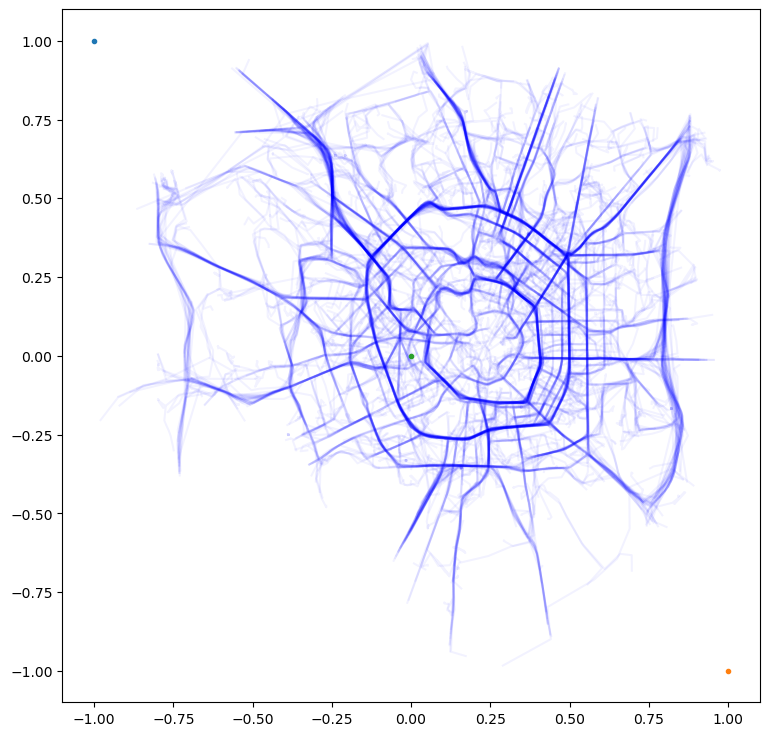

In [338]:
plt.figure(figsize=(9,9))

for i in range(0, df_milan.shape[0], 30):
    plt.plot(df_milan.iloc[i,1::2], df_milan.iloc[i,0::2], 'blue', alpha=0.05)

plt.plot(-1, 1, marker='.', ls='none')
plt.plot(1, -1, marker='.', ls='none')
plt.plot(0, 0, marker='.', ls='none')

### <a id='toc1_2_2_'></a>[Projection on lat/long coordinates](#toc0_)

Projection of coordinates from -1,1 to real longitude and latitude coordinates

In [339]:
# Reference point for Milan 
# longitude ~ X
min_long = 9.043
max_long = 9.275
# latitude ~ Y
min_lat = 45.39
max_lat = 45.53537

# width and height of map zone
width_map = max_long - min_long
height_map = max_lat - min_lat

# central coordinate of the map
center_lat = min_lat + height_map / 2
center_long = min_long + width_map / 2
# center_long = 9.158968137574597
# center_lat = 45.46317951874455

milan_geo = pd.DataFrame()

# Projection of each point
for i in range(-8,12):
    x_col = f'x(t{i:+})' if i != 0 else 'x(t)'
    y_col = f'y(t{i:+})' if i != 0 else 'y(t)'
    long = f'long(t{i:+})' if i != 0 else 'long(t)'
    lat = f'lat(t{i:+})' if i != 0 else 'lat(t)'
    
    # Y = aX + b
    milan_geo[long] = df_milan[y_col] * (width_map /2) + center_long
    milan_geo[lat] = df_milan[x_col] * (height_map /2) + center_lat

df.head()

,long(t-8),lat(t-8),long(t-7),lat(t-7),long(t-6),lat(t-6),long(t-5),lat(t-5),long(t-4),lat(t-4),...,distance(t+7),vitesse(t+7),distance(t+8),vitesse(t+8),distance(t+9),vitesse(t+9),distance(t+10),vitesse(t+10),distance(t+11),vitesse(t+11)
0,9.066160,45.500351,9.066634,45.497379,9.075206,45.497504,9.090846,45.503499,9.093593,45.504947,...,0.000000,0.000000,0.005551,0.333062,0.005551,0.333062,0.005579,0.334718,0.005579,0.334718
1,9.245124,45.423970,9.245094,45.424319,9.245065,45.424669,9.245104,45.425169,9.245144,45.425668,...,0.310437,18.626216,0.310437,18.626216,0.184087,11.045249,0.184087,11.045249,0.243059,14.583548
2,9.245124,45.424769,9.245184,45.425768,9.246291,45.427666,9.249533,45.429864,9.253745,45.433361,...,0.202898,12.173886,0.202898,12.173886,0.124686,7.481145,0.124686,7.481145,0.160706,9.642364
3,9.074119,45.437757,9.074739,45.446390,9.077176,45.458589,9.077367,45.466998,9.077460,45.476273,...,0.048594,2.915637,0.067836,4.070155,0.067836,4.070155,0.008491,0.509454,0.008491,0.509454
4,9.245234,45.423570,9.245553,45.426667,9.246012,45.427367,9.246635,45.427916,9.247259,45.428466,...,0.919990,55.199422,1.347159,80.829514,0.742089,44.525344,0.939493,56.369586,0.975012,58.500724


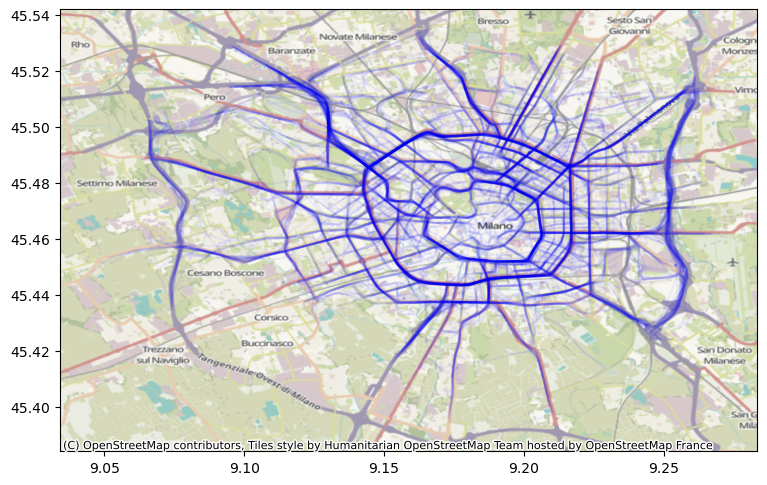

In [340]:
fig, ax = plt.subplots(figsize=(9,9))

for i in range(0, df.shape[0], 30):
    ax.plot(milan_geo.iloc[i,0:40:2], 
            milan_geo.iloc[i,1:41:2], 'blue', alpha=0.05)
    
# Add map background
cx.add_basemap(ax, crs='EPSG:4326', source=cx.providers.OpenStreetMap.HOT)

### <a id='toc1_2_3_'></a>[Distance and Speed calculation](#toc0_)

Let's calculate distance and speed from coordinates

In [341]:
for i in range(-8,11):
    lat_col1 = f'lat(t{i:+})' if i != 0 else 'lat(t)'
    long_col1 = f'long(t{i:+})' if i != 0 else 'long(t)'
    lat_col2 = f'lat(t{i+1:+})' if i+1 != 0 else 'lat(t)'
    long_col2 = f'long(t{i+1:+})' if i+1 != 0 else 'long(t)'
    
    dist = f'dist(t{i+1:+})' if i+1 != 0 else 'dist(t)'
    speed = f'speed(t{i+1:+})' if i+1 != 0 else 'speed(t)'
    
    # Distance = V(dX² + dY²) * 1.852 * 60 (1 minute of arc = 1 nautical mile = 1,852km, multiplied by 60 for degrees)
    milan_geo[dist] = (((milan_geo[lat_col2] - milan_geo[lat_col1])**2 
                        + (milan_geo[long_col2] - milan_geo[long_col1])**2)**0.5) * 1.852 * 60
    # Speed = d/t (km/min * 60 = km/h)
    milan_geo[speed] = milan_geo[dist] * 60

I wanted a colored plot depending on the speed, didn't find an easiest way too do so...

C:\Users\octav\AppData\Local\Temp\ipykernel_25612\782285361.py:5: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



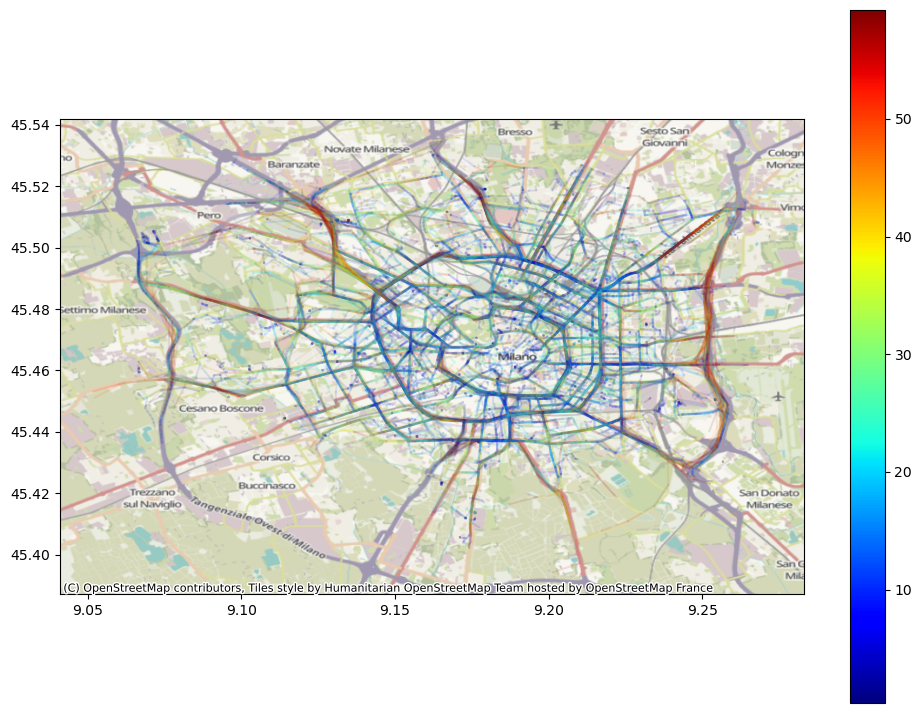

In [342]:
def plot_colourline(x,y,c):
    col = cm.jet((c-np.min(c))/(np.max(c)-np.min(c)))
    ax = plt.gca()
    for i in np.arange(len(x)-1):
        ax.plot([x[i],x[i+1]], [y[i],y[i+1]], c=col[i], alpha=0.1)
    im = ax.scatter(x, y, c=c, s=0, cmap=cm.jet)
    return im

fig, ax = plt.subplots(figsize=(12,9))

for i in range(0, milan_geo.shape[0], 30):
    im = plot_colourline(x=milan_geo.iloc[i,2:40:2], 
                         y=milan_geo.iloc[i,3:41:2], 
                         c=milan_geo.iloc[i,41::2])
fig.colorbar(im)
cx.add_basemap(ax, crs='EPSG:4326', source=cx.providers.OpenStreetMap.HOT)

Animation size has reached 22677226 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


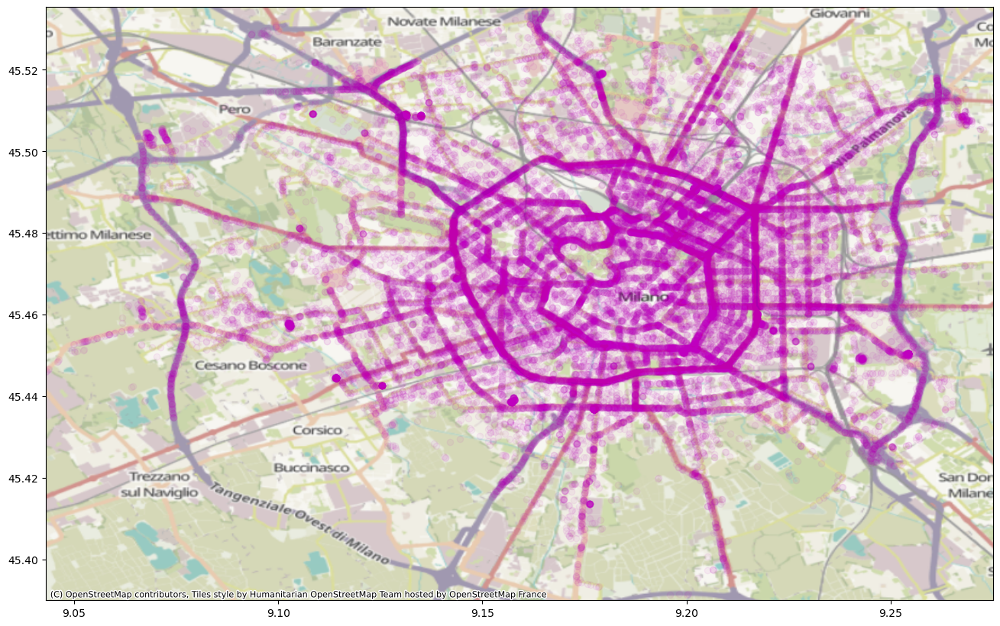

In [343]:
fig, ax = plt.subplots(figsize=(16,16))

s = ax.scatter([],[], color='m', alpha=0.05)
ax.set_xlim(min_long, max_long)
ax.set_ylim(min_lat, max_lat)
s.set_animated(True)

def update(i):
    i -= 8
    long_col = f'long(t{i:+})' if i != 0 else 'long(t)'
    lat_col = f'lat(t{i:+})' if i != 0 else 'lat(t)'
    s.set_offsets(milan_geo[[long_col,lat_col]])

ani = animation.FuncAnimation(fig, update, frames=20)

cx.add_basemap(ax, crs='EPSG:4326', source=cx.providers.OpenStreetMap.HOT)

HTML(ani.to_jshtml())
# ani.save(filename="milan.gif")

### <a id='toc1_2_4_'></a>[Interactive map](#toc0_) 

An interactive map of road axes flow with plotly  
(RAM needed for this one)

In [344]:
fig = go.Figure()

# Only a few rows shown because of lag
for i in range(0, milan_geo.shape[0], 100):
    fig.add_trace(go.Scattermapbox(
        mode = "lines",
        lat = milan_geo.iloc[i,3:41:2],
        lon = milan_geo.iloc[i,2:40:2],
        line=dict(color="blue"),
        opacity = 0.05))
    
fig.update_layout(
    mapbox = {
        'center': {'lon':center_long, 'lat': center_lat},
        'style': "open-street-map",
        'zoom': 10},
    margin = {'l':0, 'r':0, 'b':0, 't':0})

fig.show()

## <a id='toc1_3_'></a>[Naples](#toc0_)

## <a id='toc1_4_'></a>[Rome](#toc0_)

## <a id='toc1_5_'></a>[Turin](#toc0_)